In [3]:
import numpy as np
from joblib import Parallel, delayed

import matplotlib.pyplot as plt
from numba import njit
import sys
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [4]:
dt = 1e-5; dB = dt**0.5
@njit
def simulate_ddm(v, a, dt, dB):
    # assume starting pt = 0, sigma = 1, boundaries -a, +a
    DV = 0; t = 0 
    while True:
        DV += v*dt + np.random.normal(0, dB)
        t += 1

        if DV >= a:
            return +1, t*dt
        elif DV <= -a:
            return -1, t*dt

In [5]:
def parse_sim_results(results):
    choices =  [r[0] for r in results]
    rts = [r[1] for r in results]
    return choices, rts

In [14]:
v = 1; N_sim = 10000

a = 2
sim_results1 = Parallel(n_jobs=-1)(delayed(simulate_ddm)(v, a, dt, dB) for _ in range(N_sim))

print('1 done')
a = 10
sim_results2 = Parallel(n_jobs=-1)(delayed(simulate_ddm)(v, a, dt, dB) for _ in range(N_sim))

1 done


In [15]:
_, rt_low_bound = parse_sim_results(sim_results1)
_, rt_high_bound = parse_sim_results(sim_results2) 

Consider 2 values for the decision threshold (low thresholds should correspond to right-
skewed RTDs, whereas for high thresholds the RTDs become more symmetric and Gaussian-
like). For each of these four cases select 9 values of the strength of evidence (4 positive, 4
negative and zero) spanning from change level to 100% accuracy.

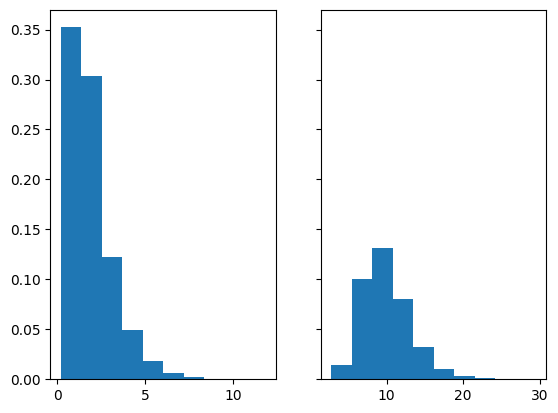

In [16]:
fig, axs = plt.subplots(1, 2, sharey=True)
axs[0].hist(rt_low_bound, density=True);
axs[1].hist(rt_high_bound, density=True);


# Bound, Velocity 

In [6]:
bound_arr = np.array([2,10])

velocity_arr = np.array([-4,-3,-2,-1,0,1,2,3,4])


In [7]:
def prob_hit_low_bound(v,a,w):
    if v == 0:
        return 1 - w
    else:
        return (1 - np.exp(-2*v*a*(1-w)))/(np.exp(2*v*w*a) - np.exp(-2*v*a*(1-w)))

In [49]:
prob_high_bound_hit = np.zeros((len(bound_arr), len(velocity_arr)))
w = 0.5
for i,a in enumerate(bound_arr):
    for j,v in enumerate(velocity_arr):
        prob_high_bound_hit[i,j] = 1-prob_hit_low_bound(v,a,w) 

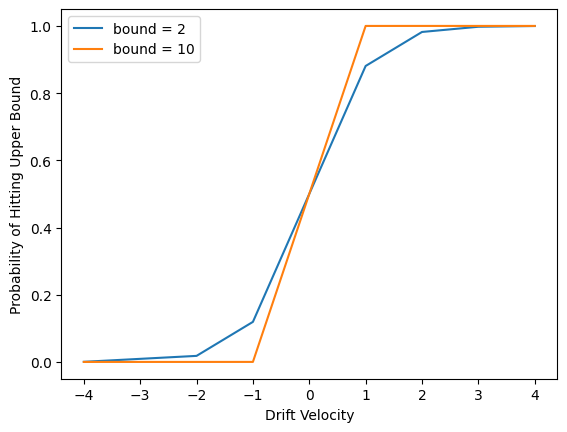

In [54]:
fig, ax = plt.subplots()
for i,b in enumerate(bound_arr):
    ax.plot(velocity_arr, prob_high_bound_hit[i,:], label = f'bound = {b}');
ax.set_xlabel('Drift Velocity')
ax.set_ylabel('Probability of Hitting Upper Bound')
ax.legend();


In [8]:
@njit
def total_rt_density(t, mu):
    if t > 0.25:
        sum_term = 0.0
        for k in range(101):  # Sum up to 100 terms
            term = (-1)**k * (2*k + 1) * np.exp(-((2*k + 1)**2 * np.pi**2 * t) / 8)
            sum_term += term
        
        result = (np.pi / 2) * np.cosh(mu) * np.exp(-mu**2 * t / 2) * sum_term
    else:
        cosh_mu = np.cosh(mu)
        exp_mu_t = np.exp(-mu**2 * t / 2)
        prefactor = 2 * cosh_mu * exp_mu_t / (np.sqrt(2 * np.pi) * t**(3/2))
        
        summation = 0
        for k in range(101):
            term = ((-1)**k) * (2*k + 1) * np.exp(-((2*k + 1)**2) / (2 * t))
            summation += term
    
        result = prefactor * summation
    
    if result < 0:
        print('neg for t = ',t, 'mu = ',mu, 'res = ', result)
        # sys.exit()
    return result

In [6]:
N_t = 1000;t_pts = np.linspace(0.1,10,N_t)
v_vs_total_rt_density = np.zeros((len(velocity_arr), N_t))

for i, v in enumerate(velocity_arr):
    prob_t_total = [total_rt_density(t,v) for t in t_pts]
    v_vs_total_rt_density[i,:] = prob_t_total


Total densities for +v should be same as -v

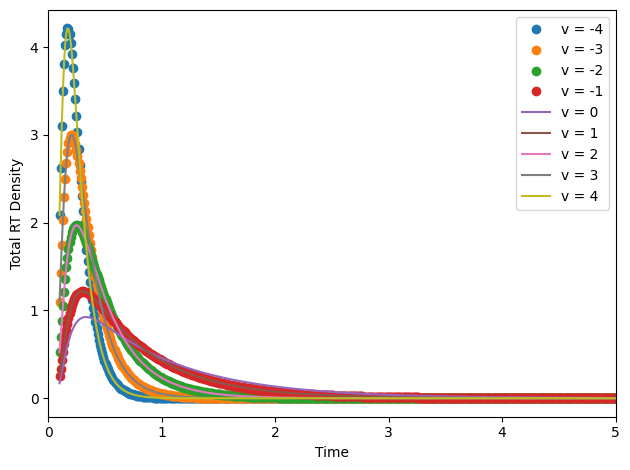

In [8]:
fig, ax = plt.subplots()
for i,v in enumerate(velocity_arr):
    if v < 0:
        ax.plot(t_pts, v_vs_total_rt_density[i,:], label = f'v = {v}', linestyle='None', marker='o');
    else:
        ax.plot(t_pts, v_vs_total_rt_density[i,:], label = f'v = {v}', linestyle='-');
ax.set_xlabel('Time')
ax.set_ylabel('Total RT Density')
ax.set_xlim([0,5])
ax.legend();
fig.tight_layout()


In [8]:
N_sim = 50000;all_sim_results = {}
for a in bound_arr:
    for v in velocity_arr:
        if a == 10 and v == 0:
            continue
        keyname = f"a={str(a)},v={str(v)}"
        sim_results = Parallel(n_jobs=-1)(delayed(simulate_ddm)(v, a, dt, dB) for _ in range(N_sim))
        all_sim_results[keyname] = sim_results

        print('completed ', keyname)

completed  a=2,v=-4
completed  a=2,v=-3
completed  a=2,v=-2
completed  a=2,v=-1
completed  a=2,v=0
completed  a=2,v=1
completed  a=2,v=2
completed  a=2,v=3
completed  a=2,v=4
completed  a=10,v=-4
completed  a=10,v=-3
completed  a=10,v=-2
completed  a=10,v=-1
completed  a=10,v=1
completed  a=10,v=2
completed  a=10,v=3
completed  a=10,v=4


In [9]:
import pickle
with open('all_sim_results.pkl', 'wb') as f:
    pickle.dump(all_sim_results, f)

In [9]:
import pickle
with open('all_sim_results.pkl', 'rb') as f:
    all_sim_results = pickle.load(f)


In [21]:
def rtd_low_bound(t, v, a, w):
    term1 = (np.pi/a**2)*np.exp(-v*a*w - (v**2 * t/2))
    term2 = [ k * np.exp(-(k**2 * np.pi**2 * t)/(2 * a**2)) * np.sin(k*np.pi*w) for k in range(1,101) ]
    return term1*np.sum(term2)

def ftpd_3(t, v, a, w):
    term1 = ((np.pi)/(a**2))*np.exp(v*a*w-(v**2 * t/2))
    term2 = [ k * np.exp(-(k**2 * np.pi**2 * t)/(2 * a**2)) * np.sin(k*np.pi*w) for k in range(1,100) ]
    return term1*np.sum(term2)

In [20]:
ftpd_3(0.25, -4, 2, 0.5), rtd_low_bound(0.25, -4, 2, 0.5)

(3.1915371657305203, 3.1915371657305203)

In [57]:
from scipy import integrate
w = 0.5
for a in bound_arr:
    for v in velocity_arr:
        if v == 0:
            continue
        keyname = f"a={str(a)},v={str(v)}"
        choices, RTs = parse_sim_results(all_sim_results[keyname])

        if v < 0:
            mu = v
            prefered_bound = -1
        else:
            mu = -v # also w = 1 - w, but not req since w = 0.5
            prefered_bound = 1

        
        RTs_prefered = [RTs[i] for i in range(len(choices)) if choices[i] == prefered_bound]
        t_pts = np.linspace(0.001, max(RTs_prefered), 1000)
        
        # delta_t = 0.001; t = min(RTs_prefered); t_max = max(RTs_prefered); RT_theory = []
        # while t + delta_t <= t_max:
        #     result,_ = integrate.quad(rtd_low_bound, t, t+delta_t, args=(v, a, w))
        #     RT_theory.append(result)
        #     t += delta_t  
        # 
        t_pts = np.linspace(min(RTs_prefered), max(RTs_prefered), 1000)
        RT_theory = [rtd_low_bound(t, mu, a, w) for t in t_pts]


        # Create the histogram and overlay the theoretical curve
        fig = go.Figure()

        # Histogram for RTs_prefered
        fig.add_trace(
            go.Histogram(x=RTs_prefered, histnorm='probability', name='RTs Preferred', marker=dict(color='blue'))
        )

        # Theoretical curve for RTs
        fig.add_trace(
            go.Scatter(x=t_pts, y=RT_theory, mode='lines', name='Theoretical Curve', line=dict(color='red'))
        )

        # Update layout
        fig.update_layout(
            title=keyname,
            xaxis_title='RTs Preferred',
            yaxis_title='Probability'
        )

        # Show the plot
        fig.show()

        
        

        # break
    # break


# compare large and small times

In [74]:
def f_l_small_times(t, mu):
    cosh_mu = np.cosh(mu)
    exp_mu_t = np.exp(-mu**2 * t / 2)
    prefactor = 2 * cosh_mu * exp_mu_t / (np.sqrt(2 * np.pi * t**(3)) )
    
    summation = 0
    for k in range(101):
        term = ((-1)**k) * (2*k + 1) * np.exp(-((2*k + 1)**2) / (2 * t))
        summation += term
    
    result = prefactor * summation
    return result


def f_l_large_times(t, mu):
    cosh_mu = np.cosh(mu)
    exp_mu_t = np.exp(-mu**2 * t / 2)
    prefactor = (np.pi / 2) * cosh_mu * exp_mu_t
    
    summation = 0
    for k in range(101):
        term = ((-1)**k) * (2*k + 1) * np.exp(-((2*k + 1)**2 * np.pi**2 * t) / 8)
        summation += term
    
    result = prefactor * summation
    return result

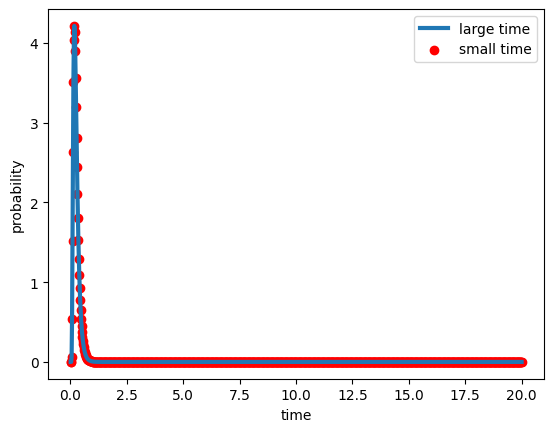

In [91]:
time_range = np.linspace(0.01,20, 1000);

mu = -4;
large_prob = [f_l_large_times(t,mu) for t in time_range]
small_prob = [f_l_small_times(t,mu) for t in time_range]

plt.plot(time_range, large_prob, label = 'large time', linewidth=3)
plt.scatter(time_range, small_prob, label = 'small time', color='red')
plt.xlabel('time')
plt.ylabel('probability')
plt.legend()
plt.show()


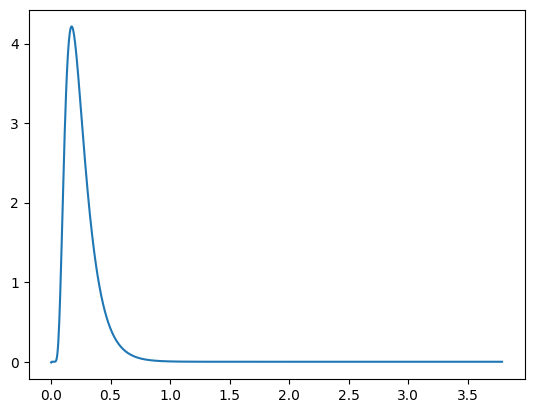

In [42]:

def ftpd_3(t, v, a, w):
    term1 = ((np.pi)/(a**2))*np.exp(-v*a*w-(v**2 * t/2))
    term2 = [ k * np.exp(-(k**2 * np.pi**2 * t)/(2 * a**2)) * np.sin(k*np.pi*w) for k in range(1,100) ]
    # print(term1, np.sum(term2), term1*np.sum(term2))
    return term1*np.sum(term2)

t_pts = np.linspace(0.001, max(RTs_prefered)+2, 1000)
# RT_theory = [rtd_low_bound(t,mu,a,0.5) for t in t_pts]
RT_theory = [ftpd_3(t,mu,a,0.5) for t in t_pts]

plt.plot(t_pts, RT_theory);
t=0.25;w=0.5; mu=-4;a=2;
# print(ftpd_3(t,mu,a,w))